#### Load packages

In [1]:
import os
import scanpy as sc
from copy import copy
import numpy as np 
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
import tifffile
import scipy.ndimage
import squidpy as sq

warnings.filterwarnings('ignore')
sc.set_figure_params(dpi=80, dpi_save=400)

/Users/choyeonju/miniconda3/envs/torch/lib/python3.11/site-packages/dask/dataframe/__init__.py:31: FutureWarning: The legacy Dask DataFrame implementation is deprecated and will be removed in a future version. Set the configuration option `dataframe.query-planning` to `True` or None to enable the new Dask Dataframe implementation and silence this warning.
  warnings.warn(
/Users/choyeonju/miniconda3/envs/torch/lib/python3.11/site-packages/anndata/utils.py:429: FutureWarning: Importing read_text from `anndata` is deprecated. Import anndata.io.read_text instead.
  warnings.warn(msg, FutureWarning)


#### manually annotated cell types based on DE markers

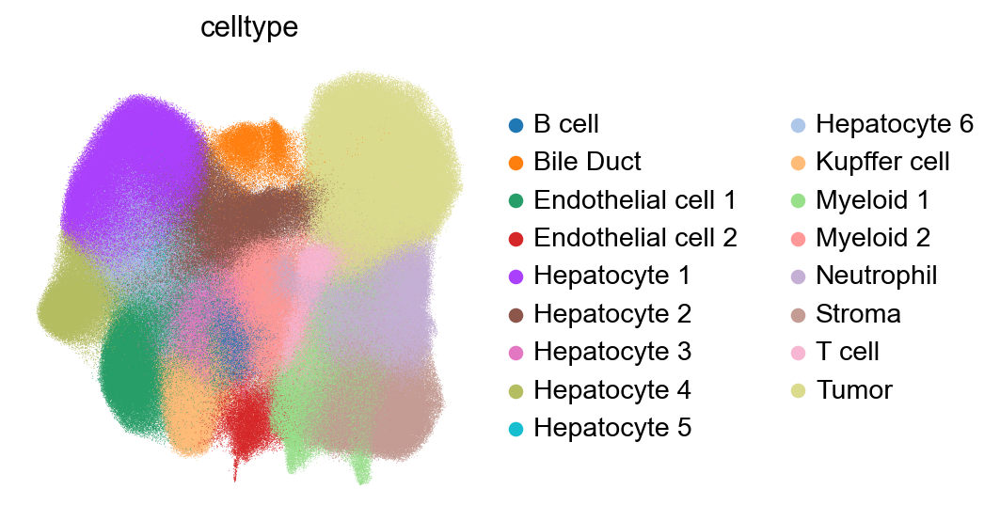

In [2]:
adata_integrated= sc.read_h5ad('./backup/integrated.h5ad')
adata_integrated.obs['celltype'] =adata_integrated.obs['leiden'].map({
    "0":"Hepatocyte 1",
    "1":"Tumor",
    "2":"Stroma",
    "3":"Neutrophil",
    "4":"Endothelial cell 1",
    "5":"Tumor",
    "6":"Myeloid 1",
    "7":"Hepatocyte 2",
    "8":"Hepatocyte 6",
    "9":"Myeloid 2",
    "10":"Hepatocyte 3",
    "11":"Kupffer cell",
    "12":"Hepatocyte 4",
    "13":"T cell",
    "14":"Bile Duct",
    "15":"Endothelial cell 2",
    "16":"B cell",
    "17":"Hepatocyte 5"
})
sc.pl.umap(adata_integrated, color = ['celltype'], s=0.6, frameon = False, save='_Suppl_Fig9C.pdf')

#### Celltype phenotype heatmap

In [3]:
# selected markers 
markers = ['Mmp9', 'Itgam','Cxcr2','Siglecf','Mpo','Ly6g',
           'Itgax', 'H2-DMa', 'H2-Ab1',
           'Cd3e', 'Cd8a', 'Cd8b1',
           'Col1a1', 'Col3a1', 'Col5a2',
           'Eng', 'Mrc1', 'Pecam1',
           'Clec4f', 'Adgre1', 'Cd163','Cd68',
           'Cd79a', 'Cd19',
           'Apoh', 'Uox', 'Hrg',
           'Lcn2','Isg15','Rsad2',
           'Ifit1','Ifit3','Cxcl10',
           'Epcam','Krt20', 'Krt19',
           'Sema5a', 'Fgfr1', 'Adamts5'
          ]


celltype_order = ['Neutrophil','Myeloid 1','Myeloid 2',
                  'T cell',
                  'Stroma',
                  'Endothelial cell 1','Endothelial cell 2',
                  'Kupffer cell',
                  'B cell',
                  'Hepatocyte 1', 'Hepatocyte 2', 'Hepatocyte 3','Hepatocyte 4','Hepatocyte 5','Hepatocyte 6',
                  'Tumor' ,'Bile Duct'              
                 ] 

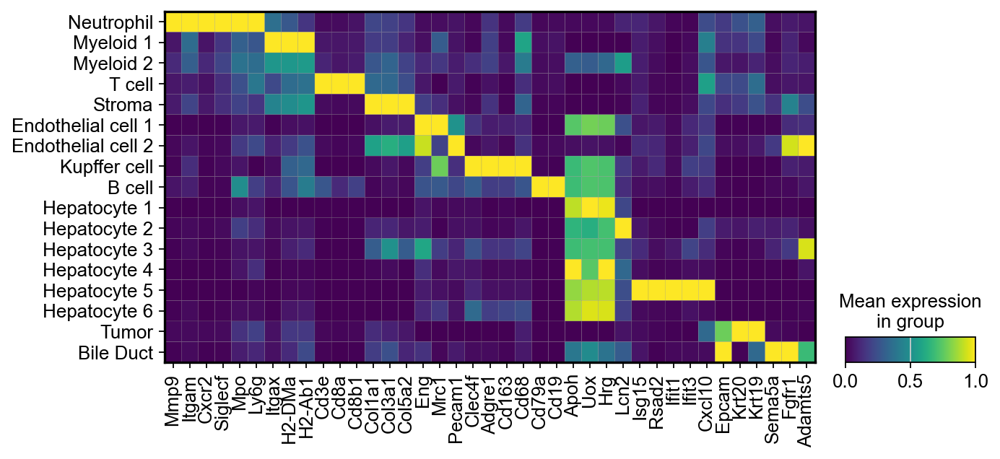

In [4]:
adata_integrated.obs['celltype'] = pd.Categorical(adata_integrated.obs['celltype'], categories=celltype_order, ordered=True)

sc.pl.matrixplot(adata_integrated, 
                 markers, 
                 standard_scale='var', 
                 groupby='celltype',
                 var_group_rotation=0,
                 dendrogram=False,
                 figsize=(9,4),
                 save='Suppl_Fig9D.pdf')

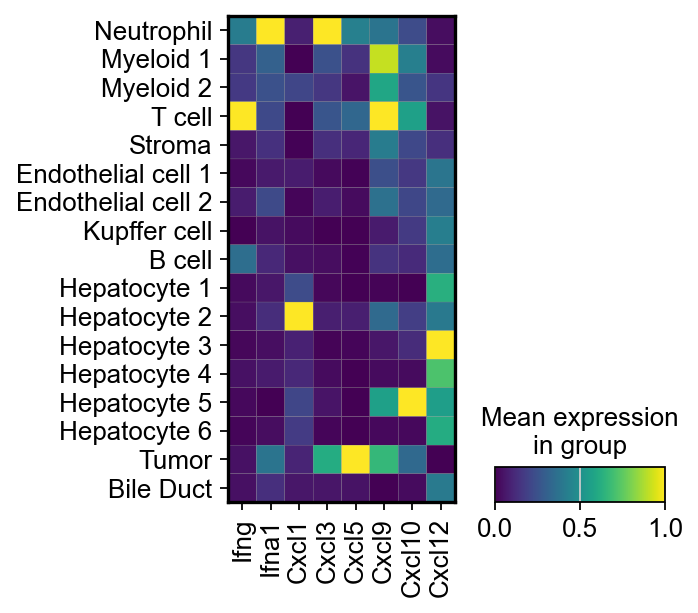

In [5]:
# Select Cxcl markers
markers_cxcl = ['Ifng', 'Ifna1', 'Cxcl1', 'Cxcl3','Cxcl5','Cxcl9', 'Cxcl10', 'Cxcl12']
celltype_order = ['Neutrophil','Myeloid 1','Myeloid 2',
                  'T cell','Stroma','Endothelial cell 1','Endothelial cell 2',
                  'Kupffer cell','B cell', 'Hepatocyte 1', 'Hepatocyte 2', 'Hepatocyte 3','Hepatocyte 4','Hepatocyte 5','Hepatocyte 6',
                  'Tumor' ,'Bile Duct'              
                 ] 

adata_integrated.obs['celltype'] = pd.Categorical(adata_integrated.obs['celltype'], categories=celltype_order, ordered=True)
sc.pl.matrixplot(adata_integrated, 
                 markers_cxcl, 
                 standard_scale='var', 
                 groupby='celltype',
                 var_group_rotation=0,
                 dendrogram=False,
                 figsize=(3.5,4),
                 save='Suppl_Fig9F.pdf')

#### Cell type annotation validation 

In [6]:
celltype_palette = {
    "Hepatocyte 1": "#f0c2f0",  # pink
    "Hepatocyte 2": "#f0c2f0",
    "Hepatocyte 3": "#f0c2f0",
    "Hepatocyte 4": "#f0c2f0",
    "Hepatocyte 5": "#f0c2f0",
    "Hepatocyte 6": "#f0c2f0",
    "Myeloid 1": "#faf148",  #yellow 
    "Myeloid 2": "#faf148",
    "Tumor": "#808080",  # Grey for Tumor
    "Endothelial cell 1": "#ff9900",  # orange
    "Endothelial cell 2": "#ff9900",
    "Neutrophil": "#0011ff",  # blue 
    "T cell": "#ff0000",  # red 
    "Bile Duct": "#21bf26",  # green
    "Kupffer cell": "#f538f5",  # purple pink 
    "B cell": "#8a4819",  #brown
    "Stroma": "#aaecf0",  # skyblue
}

Skipping folder AgOFF_CXCR2inh_5.
Skipping folder AgOFF_CXCR2inh_3.


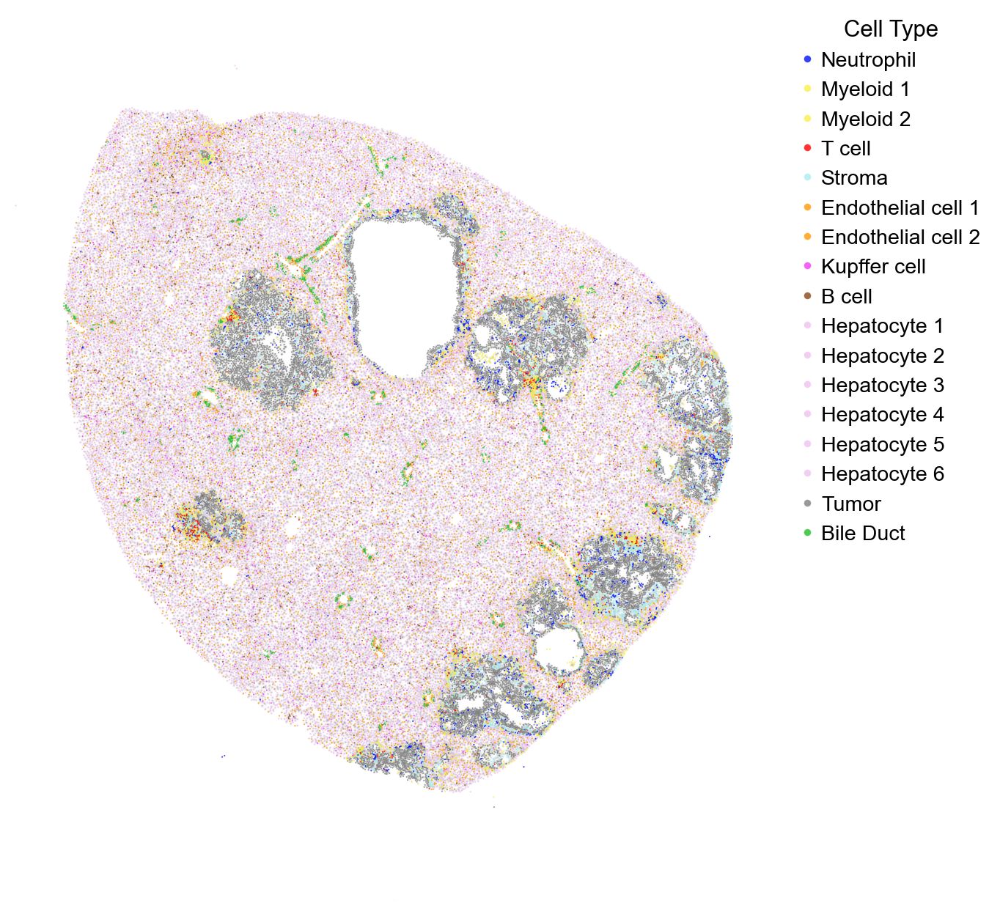

Skipping folder AgOFF_2.


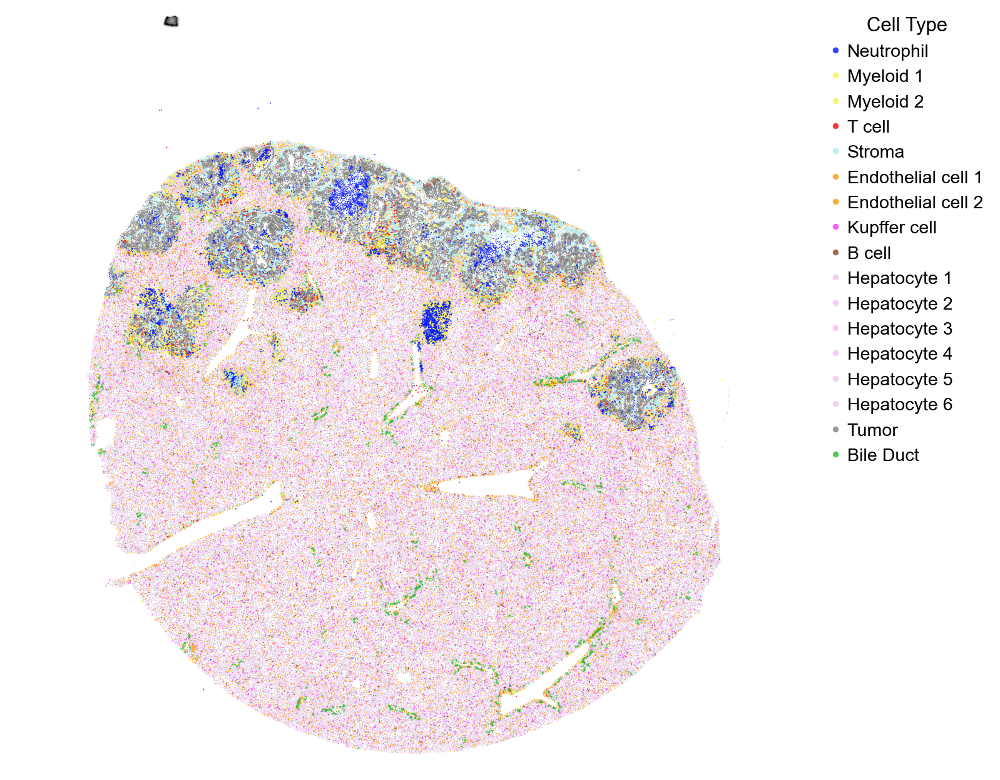

Skipping folder AgON_7.


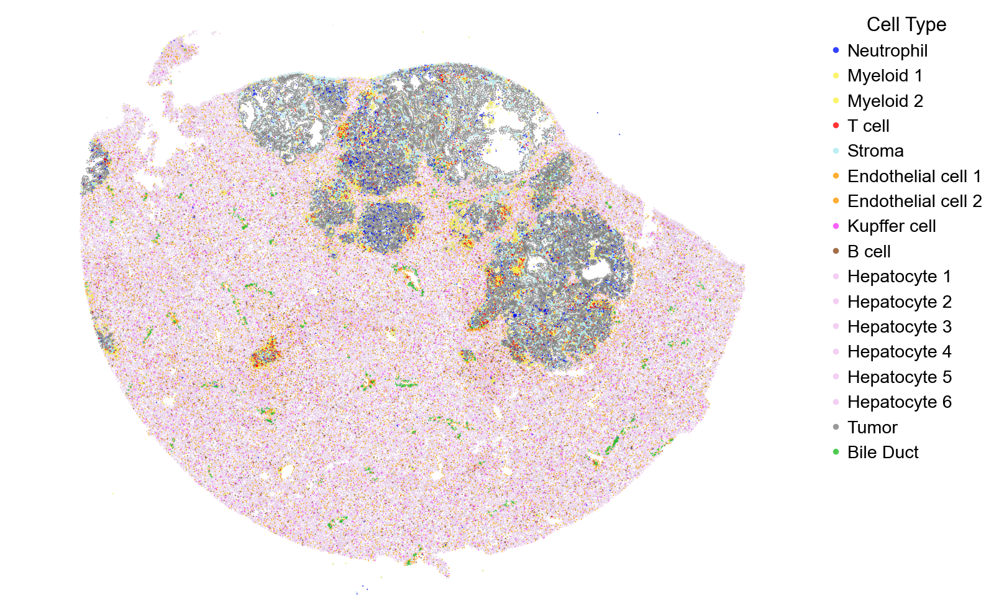

Skipping folder AgON_8.


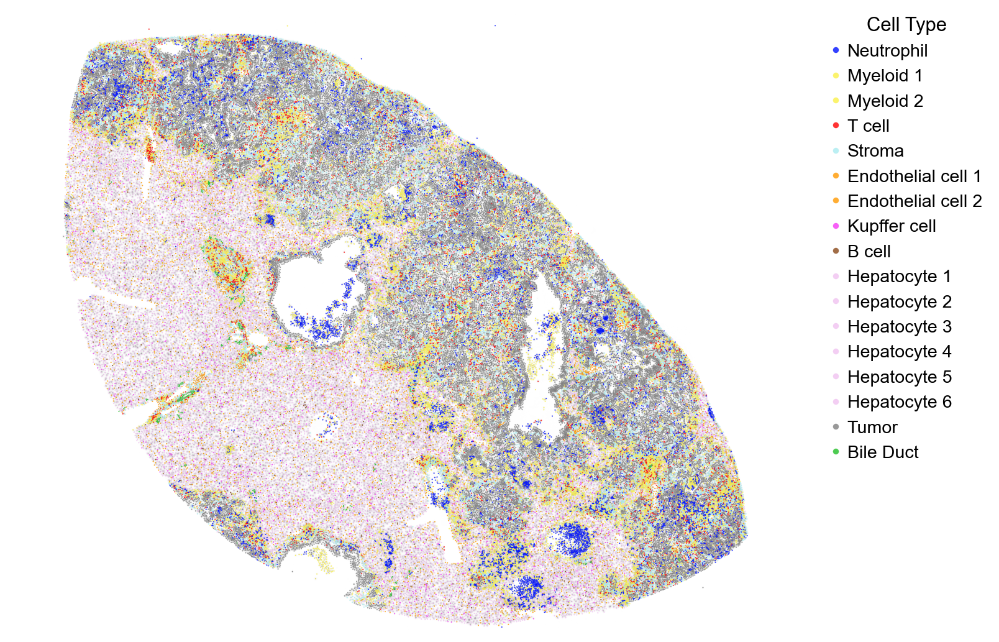

Skipping folder AgOFF_1.
Skipping folder AgON_CXCR2inh_11.
Skipping folder AgON_CXCR2inh_10.


In [7]:
# Define the representative sample ID for each condition
condition_to_sample = {
    'AgOFF_0': '0',
    'AgON_6': '6',
    'AgOFF_CXCR2inh_4': '4',
    'AgON_CXCR2inh_9': '9'
}

# Get list of folders in spatial_plots
spatial_plots_dir = './spatial_plots'
ag_folders = [folder for folder in os.listdir(spatial_plots_dir) if 'Ag' in folder]

# Loop through each folder
for folder in ag_folders:
    # Extract the condition and corresponding sample
    condition = folder  # folder name labelled with condition and sample ID 
    sample = condition_to_sample.get(condition)
    
    if sample is None:
        print(f"Skipping folder {folder}.")
        continue
    
    # Load MIP image for current folder
    mipurl = os.path.join(spatial_plots_dir, folder, 'morphology_mip.ome.tif')
    with tifffile.TiffFile(mipurl) as tif:
        image = tif.series[0].levels[0].asarray()

        # Rescale image
        resample = scipy.ndimage.zoom(image, 0.2125)

    # Filter adata for the current sample
    adata_filter = adata_integrated[adata_integrated.obs['sample'] == sample]
    
    # Plot the rescaled image
    plt.rcParams["figure.figsize"] = (10, 10)
    plt.imshow(resample, cmap='binary')

    sns.scatterplot(
        x='x_centroid', y='y_centroid',
        data=adata_filter.obs, 
        palette=celltype_palette ,
        hue='celltype',  s=0.7, alpha=0.8,
        legend='full', edgecolor=None
    )

    # Remove title, x/y axis labels, and ticks
    plt.title('')
    plt.xlabel('')
    plt.ylabel('')
    plt.xticks([])
    plt.yticks([])

    # Remove the border around the plot
    for spine in plt.gca().spines.values():
        spine.set_visible(False)

    legend = plt.legend(
    title='Cell Type',
    bbox_to_anchor=(1.05, 1),     # outside the plot to the right
    loc='upper left',
    borderaxespad=0.,
    frameon=False,
    markerscale=5) # increase dot size in legend

    output_pdf = f'{folder}_whole_plot_celltypesMarked.pdf'
    plt.savefig(output_pdf, format='pdf', bbox_inches='tight')
    plt.show()
    plt.close()

#### Subclustering Neutrophils

In [8]:
# filter neutrophils 
adata_subset3 = adata_integrated[adata_integrated.obs['leiden'] == '3'].copy() # cluster 3 is annotated as Neutrophils 
print(adata_subset3.obsp.keys())
# sub-cluster neutrophils 
sc.tl.umap(adata_subset3)
sc.tl.leiden(adata_subset3, resolution=0.3)

KeysView(PairwiseArrays with keys: connectivities, distances)


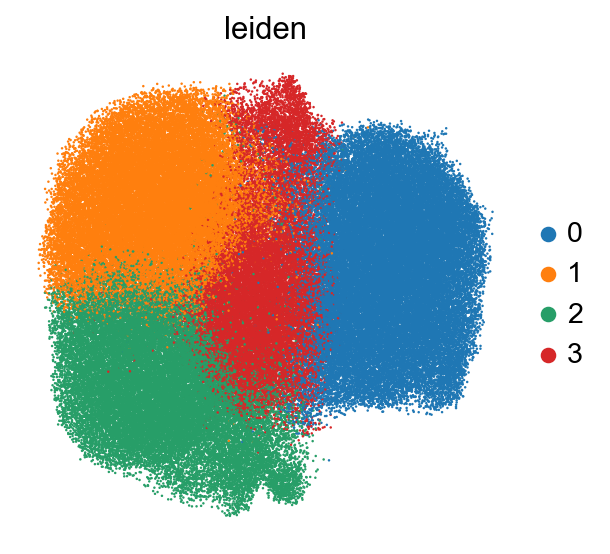

In [9]:
sc.set_figure_params(dpi=80, dpi_save=400)
sc.pl.umap(adata_subset3, color=['leiden'], s=5, frameon=False,save='_Fig3D.pdf')

In [10]:
cellids= [file for file in os.listdir('./cell IDs/')]
intratumoral=pd.DataFrame(columns=['Cell ID', 'condition', 'core','ROI'])

for i in cellids:
    df = pd.read_csv('./cell IDs/'+i, skiprows=2)
    df['condition']= '_'.join(i.split("_")[0:3])
    df['core']=i.split("_")[3]
    df['ROI']=i.split("_")[4].split('.')[0]
    intratumoral = pd.concat([intratumoral, df], ignore_index=True)

In [11]:
condition_map = {
    'Ag_OFF_control': ['0', '1', '2'],
    'Ag_OFF_CXCR2': ['3', '4', '5'],
    'Ag_ON_control': ['6', '7', '8'],
    'Ag_ON_CXCR2': ['9', '10', '11']
}

In [12]:
def assign_sample(row):
    return condition_map.get(row['condition'], [])[int(row['core']) - 1] if row['core'] in ['1', '2', '3'] else None

intratumoral['sample'] = intratumoral.apply(assign_sample, axis=1)
intratumoral.drop(['X', 'Y'], axis=1, inplace=True)
intratumoral.rename(columns={'Cell ID': 'cell_id'}, inplace=True)
intratumoral

,cell_id,condition,core,ROI,Cluster,Transcripts,Area (µm^2),sample
0,bjaijefm-1,Ag_ON_CXCR2,3,10,Cluster 2,10.0,38.91,11
1,dfcedfhp-1,Ag_ON_CXCR2,3,10,Cluster 2,41.0,74.20,11
2,aeookcfb-1,Ag_ON_CXCR2,3,10,Cluster 12,6.0,12.48,11
3,egoiblnk-1,Ag_ON_CXCR2,3,10,Cluster 2,18.0,46.94,11
4,ehhblgip-1,Ag_ON_CXCR2,3,10,Cluster 14,78.0,59.71,11
...,...,...,...,...,...,...,...,...
730547,amaffcpk-1,Ag_ON_control,3,6,Cluster 3,273.0,86.93,8
730548,alppdpib-1,Ag_ON_control,3,6,Cluster 3,138.0,45.76,8
730549,iooifggm-1,Ag_ON_control,3,6,Cluster 3,122.0,46.63,8
730550,ioohckfl-1,Ag_ON_control,3,6,Cluster 9,518.0,229.24,8


In [13]:
merged_df = adata_subset3.obs.merge(intratumoral, on=['cell_id','sample'], how='inner')
merged_df

,cell_id,x_centroid,y_centroid,transcript_counts,control_probe_counts,control_codeword_counts,unassigned_codeword_counts,deprecated_codeword_counts,total_counts,cell_area,...,_scvi_batch,_scvi_labels,leiden,celltype,condition,core,ROI,Cluster,Transcripts,Area (µm^2)
0,aajimjgf-1,833.552246,1346.410034,95,0,0,0,0,95.0,33.867189,...,0,0,2,Neutrophil,Ag_OFF_control,1,9,Cluster 13,95.0,31.26
1,aajklnam-1,831.646729,1352.200317,109,0,0,0,0,109.0,37.073283,...,0,0,2,Neutrophil,Ag_OFF_control,1,9,Cluster 13,109.0,35.48
2,aakabhio-1,823.236206,1370.905640,157,0,0,0,0,157.0,65.882971,...,0,0,2,Neutrophil,Ag_OFF_control,1,9,Cluster 1,157.0,62.22
3,aakkbffl-1,825.117737,1419.810303,127,0,0,0,0,127.0,57.574221,...,0,0,2,Neutrophil,Ag_OFF_control,1,9,Cluster 13,127.0,54.24
4,aaleicno-1,832.977356,1254.842896,83,0,0,0,0,83.0,30.886876,...,0,0,2,Neutrophil,Ag_OFF_control,1,9,Cluster 13,83.0,28.66
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
111382,ofnllmok-1,3361.141113,2618.738770,190,0,0,0,0,190.0,90.222191,...,0,0,1,Neutrophil,Ag_ON_CXCR2,3,4,Cluster 11,190.0,87.79
111383,ofnnpobb-1,3374.709473,2620.709229,63,0,0,0,0,63.0,39.827814,...,0,0,3,Neutrophil,Ag_ON_CXCR2,3,4,Cluster 6,63.0,38.28
111384,ofobmpon-1,3379.535400,2629.397461,67,0,0,0,0,67.0,50.936252,...,0,0,3,Neutrophil,Ag_ON_CXCR2,3,4,Cluster 6,67.0,49.50
111385,ofoclaco-1,3327.536133,2633.225586,122,0,0,0,0,122.0,85.164691,...,0,0,2,Neutrophil,Ag_ON_CXCR2,3,4,Cluster 6,122.0,81.38


In [14]:
# Ensure 'cell_id' and 'sample' are present in both adata_subset3.obs and merged_df
adata_subset3_intratumoral = adata_subset3[adata_subset3.obs[['cell_id', 'sample']].isin(merged_df[['cell_id', 'sample']].to_dict(orient='list')).all(axis=1)].copy()

# compare with merged_df and it is matching
adata_subset3_intratumoral.obs

,cell_id,x_centroid,y_centroid,transcript_counts,control_probe_counts,control_codeword_counts,unassigned_codeword_counts,deprecated_codeword_counts,total_counts,cell_area,nucleus_area,sample,n_genes_by_counts,n_genes,_scvi_batch,_scvi_labels,leiden,celltype
aajimjgf-1-0,aajimjgf-1,833.552246,1346.410034,95,0,0,0,0,95.0,33.867189,7.315313,0,55,55,0,0,2,Neutrophil
aajklnam-1-0,aajklnam-1,831.646729,1352.200317,109,0,0,0,0,109.0,37.073283,15.037032,0,64,64,0,0,2,Neutrophil
aakabhio-1-0,aakabhio-1,823.236206,1370.905640,157,0,0,0,0,157.0,65.882971,14.224219,0,59,59,0,0,2,Neutrophil
aakkbffl-1-0,aakkbffl-1,825.117737,1419.810303,127,0,0,0,0,127.0,57.574221,28.403282,0,71,71,0,0,2,Neutrophil
aaleicno-1-0,aaleicno-1,832.977356,1254.842896,83,0,0,0,0,83.0,30.886876,9.076407,0,44,44,0,0,2,Neutrophil
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
ofnllmok-1-11,ofnllmok-1,3361.141113,2618.738770,190,0,0,0,0,190.0,90.222191,12.824375,11,59,59,0,0,1,Neutrophil
ofnnpobb-1-11,ofnnpobb-1,3374.709473,2620.709229,63,0,0,0,0,63.0,39.827814,20.591251,11,38,38,0,0,3,Neutrophil
ofobmpon-1-11,ofobmpon-1,3379.535400,2629.397461,67,0,0,0,0,67.0,50.936252,24.835938,11,38,38,0,0,3,Neutrophil
ofoclaco-1-11,ofoclaco-1,3327.536133,2633.225586,122,0,0,0,0,122.0,85.164691,29.035470,11,58,58,0,0,2,Neutrophil


#### Characterize intratumoral neutrophil subsets

In [15]:
sc.tl.rank_genes_groups(adata_subset3_intratumoral, 'leiden', method='t-test')

In [16]:
results = adata_subset3_intratumoral.uns['rank_genes_groups']

out = np.array([[0,0,0,0,0]])
for group in results['names'].dtype.names:
    out = np.vstack((out, np.vstack((results['names'][group],
                                     results['scores'][group],
                                     results['pvals_adj'][group],
                                     results['logfoldchanges'][group],
                                     np.array([group] * len(results['names'][group])).astype('object'))).T))

markers = pd.DataFrame(out[1:], columns = ['Gene', 'scores', 'pval_adj', 'lfc', 'cluster'])

markers = markers[(markers.pval_adj < 0.05) & (markers.lfc > 0.5)]

markers= markers.sort_values(by=['lfc'], ascending=False)
markers = markers.drop_duplicates(subset=['Gene'])
markers

,Gene,scores,pval_adj,lfc,cluster
590,Col1a1,247.085739,0.0,4.712558,2
591,Col3a1,228.494141,0.0,4.652139,2
594,Fstl1,101.872841,0.0,4.115075,2
595,Lum,85.110489,0.0,3.916873,2
592,Sparc,118.814766,0.0,3.721122,2
...,...,...,...,...,...
125,Tlr9,4.939959,0.000001,0.523419,0
938,Oas3,8.788272,0.0,0.522698,3
378,Card19,9.67969,0.0,0.513497,1
372,Cd177,12.163551,0.0,0.507689,1


In [17]:
# neutrophil markers
neutrophil_markers = pd.read_csv(
    "./config/Neutrophil gene list.csv", 
    header = None
)
neutrophil_markers_list = neutrophil_markers[0].tolist()


# filter genes from neutrophil marker list 
filtered_markers_table = markers[markers['Gene'].isin(neutrophil_markers_list)]

# Group the filtered DataFrame by cluster and aggregate genes into a list
cluster_genes_dict = filtered_markers_table.groupby('cluster')['Gene'].apply(list).to_dict()
cluster_genes_dict

{'0': ['Gzmb',
  'Tmsb10',
  'Mpo',
  'Prss34',
  'Fcnb',
  'Cstdc5',
  'Stfa3',
  'Retnlg',
  'Gm13822',
  'Camp',
  'Gpnmb',
  'Rgs1',
  'Rhov',
  'Ly6g',
  'Cd69',
  'Rab15',
  'Ngp',
  'Mcpt8',
  'Ccl9',
  'Ly6i',
  'Osm',
  'Mmp8',
  'Cebpe',
  'Psap',
  'Nos2'],
 '1': ['S100a6',
  'Ltf',
  'S100a11',
  'Rpsa',
  'Plac8',
  'Rps19',
  'Rplp0',
  'Rps24',
  'Plaur',
  'Rps4x',
  'Plin2',
  'AA467197',
  'Upp1',
  'Il1rn',
  'Rps11',
  'Ldha',
  'Ier3',
  'Cxcl10',
  'Card19',
  'Cd177'],
 '2': ['Ifitm3',
  'Hp',
  'Ifi27l2a',
  'Cxcr2',
  'Lst1',
  'Siglecf',
  'Lsp1',
  'Cd63',
  'Tgm2',
  'Wfdc21',
  'Ifitm1',
  'Ifitm2',
  'Ptgs1',
  'Xbp1',
  'Ninj1',
  'Wfdc17',
  'Mrpl52',
  'Slpi',
  'Socs3',
  'Lcn2',
  'Ripor2'],
 '3': ['Hcar2',
  'Ccl3',
  'Hilpda',
  'Acod1',
  'Ccrl2',
  'Gadd45b',
  'Rsad2',
  'Atp6v0c',
  'Dusp1',
  'Clec4n',
  'Nfkbia',
  'Zfp36',
  'Cebpb',
  'Ccl6',
  'Isg15',
  'Gbp5',
  'Cdkn1a']}

In [18]:
# order genes in cluster order
cluster_genes = ['Gzmb','Tmsb10','Mpo','Prss34','Fcnb','Cstdc5','Stfa3','Retnlg','Gm13822', #0 
  'Camp','Gpnmb','Rgs1','Rhov','Ly6g','Cd69','Rab15','Ngp','Mcpt8','Ccl9','Ly6i','Osm','Mmp8',
  'Cebpe','Psap','Nos2',
                  'Hcar2','Ccl3','Hilpda','Acod1','Ccrl2','Gadd45b','Rsad2','Atp6v0c','Dusp1', #3
  'Clec4n','Nfkbia','Zfp36','Cebpb','Ccl6','Isg15','Gbp5','Cdkn1a',
                  'S100a6','Ltf','S100a11','Rpsa','Plac8','Rps19','Rplp0','Rps24','Plaur', #1
  'Rps4x','Plin2','AA467197','Upp1','Il1rn','Rps11','Ldha','Ier3','Cxcl10','Card19','Cd177', 
                  'Ifitm3', 'Hp','Ifi27l2a','Cxcr2','Lst1','Siglecf','Lsp1','Cd63','Tgm2',  #2
  'Wfdc21','Ifitm1','Ifitm2','Ptgs1','Xbp1','Ninj1','Wfdc17','Mrpl52','Slpi','Socs3','Lcn2','Ripor2']

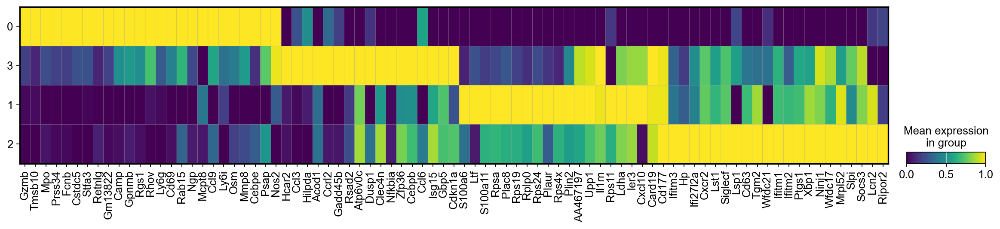

In [19]:
# order neutrophil subset groups 
manual_order = ['0', '3', '1', '2'] 

adata_subset3_intratumoral.obs["leiden"] = pd.Categorical(
    adata_subset3_intratumoral.obs["leiden"], 
    categories=manual_order, 
    ordered=True
)

sc.pl.matrixplot(adata_subset3_intratumoral, 
                 figsize=(18,3),
                 var_names=cluster_genes, 
                 groupby="leiden",
                 standard_scale='var', 
                 var_group_labels=None,
                 dendrogram=False, 
                 save='Fig3C.pdf')

#### Spatial Organization of intra-tumoral neutrophil subsets

In [20]:
# filter adata_integrated to include only Neutrophils and Tumor cells
adata_neutro_tumor = adata_integrated[
    (adata_integrated.obs['celltype'] == 'Neutrophil') |
    (adata_integrated.obs['celltype'] == 'Tumor')
].copy()

# Assign neutrophil subclustering number 
adata_neutro_tumor.obs['leiden'] = adata_neutro_tumor.obs['leiden'].astype(str)
neutrophil_idx = adata_neutro_tumor.obs.query("celltype == 'Neutrophil'").index
adata_neutro_tumor.obs.loc[neutrophil_idx, 'leiden'] = adata_subset3.obs.loc[neutrophil_idx, 'leiden'].astype(str)

#Create a set of (cell_id, sample) tuples for intratumoral neutrophils
intratumoral_keys = set(tuple(x) for x in merged_df[['cell_id', 'sample']].values)

# Apply row-wise filtering only on Neutrophils using those keys
mask_intratumoral = adata_neutro_tumor.obs.apply(
    lambda row: (
        (row['celltype'] == 'Tumor') or
        ((row['celltype'] == 'Neutrophil') and ((row['cell_id'], row['sample']) in intratumoral_keys))
    ),
    axis=1
)

# filtered intratumoral neutrophils and tumors 
adata_concat_filtered = adata_neutro_tumor[mask_intratumoral].copy()


In [21]:
def map_celltype(celltype, leiden):
    if celltype == "Neutrophil":
        return {
            "0": "N_1",
            "3": "N_2",
            "1": "N_3",
            "2": "N_4",
        }.get(leiden, leiden)  # If leiden value is not found in the mapping, return the original leiden value
    else:
        return celltype  # Return the original tumor cell types

# Apply the custom function to map values
mapped_celltype = np.vectorize(map_celltype)
adata_concat_filtered.obs['celltype'] = mapped_celltype(adata_concat_filtered.obs['celltype'], adata_concat_filtered.obs['leiden'])
adata_concat_filtered.obs

,cell_id,x_centroid,y_centroid,transcript_counts,control_probe_counts,control_codeword_counts,unassigned_codeword_counts,deprecated_codeword_counts,total_counts,cell_area,nucleus_area,sample,n_genes_by_counts,n_genes,_scvi_batch,_scvi_labels,leiden,celltype
aajenpmh-1-0,aajenpmh-1,822.016907,1336.992920,170,0,0,0,0,170.0,42.627502,24.565001,0,56,56,0,0,1,Tumor
aajicikg-1-0,aajicikg-1,825.490295,1343.973389,342,0,1,0,0,342.0,102.143441,60.554533,0,85,85,0,0,5,Tumor
aajimjgf-1-0,aajimjgf-1,833.552246,1346.410034,95,0,0,0,0,95.0,33.867189,7.315313,0,55,55,0,0,2,N_4
aajklnam-1-0,aajklnam-1,831.646729,1352.200317,109,0,0,0,0,109.0,37.073283,15.037032,0,64,64,0,0,2,N_4
aajkofce-1-0,aajkofce-1,822.528015,1351.835571,313,0,0,0,0,313.0,88.641722,47.730158,0,60,60,0,0,5,Tumor
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
ofohhdgn-1-11,ofohhdgn-1,3426.232666,2627.777588,324,0,0,0,0,324.0,98.666410,42.085627,11,72,72,0,0,1,Tumor
ofohmihp-1-11,ofohmihp-1,3426.898926,2638.312256,649,0,0,0,0,649.0,199.364851,99.208285,11,93,93,0,0,1,Tumor
ofokhdnj-1-11,ofokhdnj-1,3342.107666,2595.538330,223,0,0,0,0,223.0,98.982504,53.645627,11,76,76,0,0,1,Tumor
ofokjcni-1-11,ofokjcni-1,3346.023682,2587.058105,219,0,0,0,0,219.0,86.022659,34.138126,11,64,64,0,0,1,Tumor


In [22]:
# manual color palette 
colors = ['#1E90FF','#ff0000','#FF8C00', '#008000','#d3d3d3']

# Convert the colors to a NumPy array
colors_array = np.array(colors, dtype=object)

celltype_labels = ['N_1', 'N_2', 'N_3', 'N_4', 'Tumor'] 

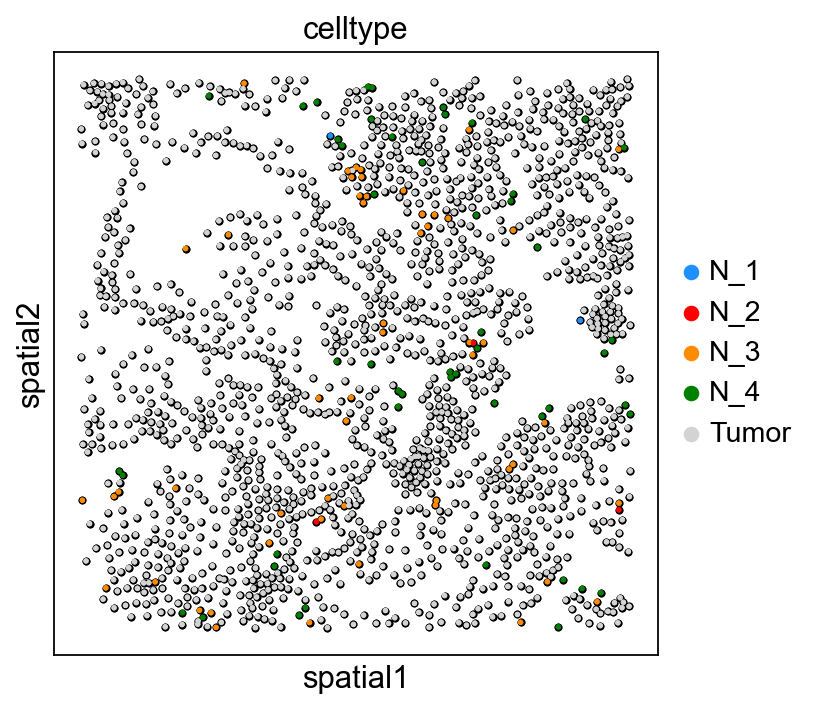

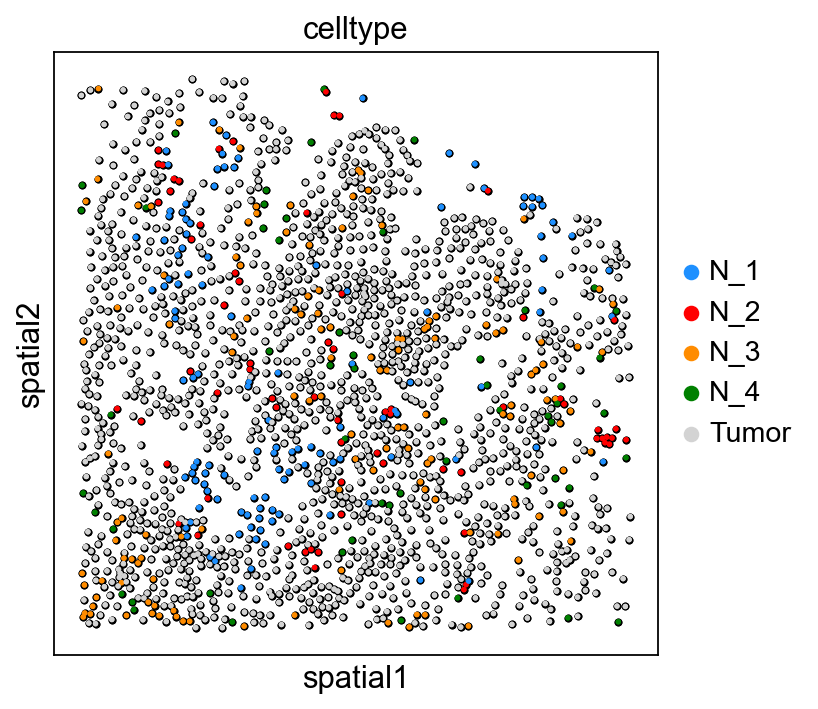

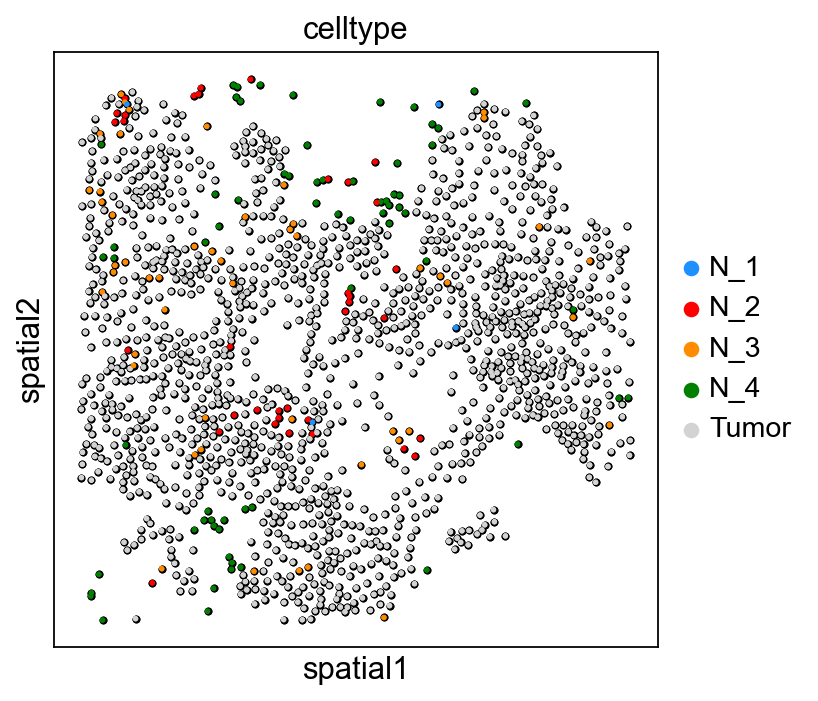

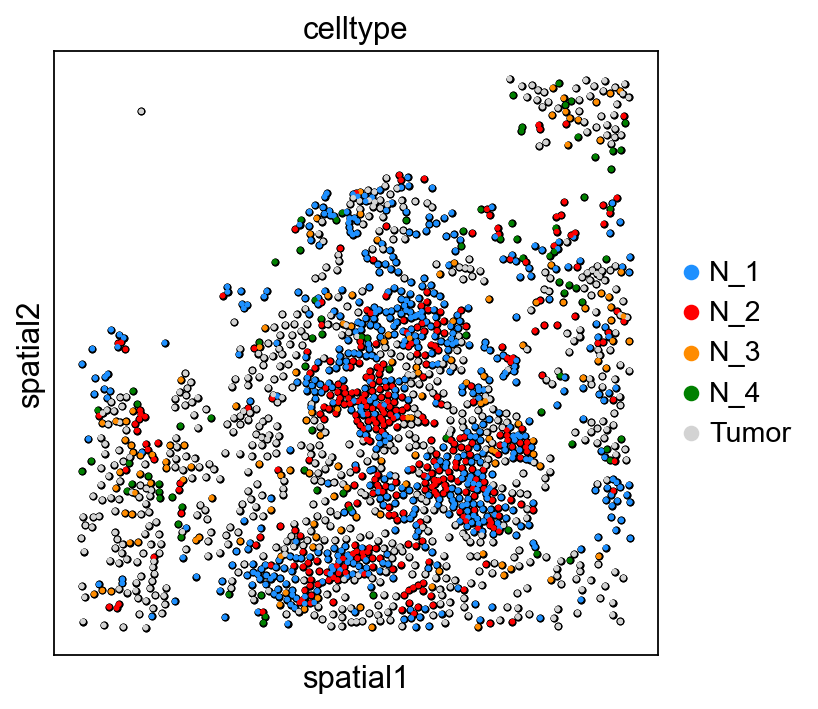

In [23]:
# Function to filter and plot each core region
def plot_core_region(
    adata, sample_id, x_range, y_range, save_name, 
    celltype_labels, colors_array, groups=None, size=8
):
    if groups is None:
        groups = celltype_labels

    # Filter by sample and coordinates
    adata_core = adata[adata.obs['sample'] == sample_id].copy()
    adata_core_xy = adata_core[
        (adata_core.obs['x_centroid'] > x_range[0]) & (adata_core.obs['x_centroid'] < x_range[1]) &
        (adata_core.obs['y_centroid'] > y_range[0]) & (adata_core.obs['y_centroid'] < y_range[1])
    ]

    # Ensure correct category order
    adata_core_xy.obs['celltype'] = adata_core_xy.obs['celltype'].astype('category')
    adata_core_xy.obs['celltype'] = adata_core_xy.obs['celltype'].cat.set_categories(celltype_labels)

    # Assign matching color palette
    adata_core_xy.uns['celltype_colors'] = colors_array

    # Plot spatial scatter
    sq.pl.spatial_scatter(
        adata_core_xy,
        library_id="spatial",
        color='celltype',
        groups=groups,
        shape=None,
        size=size,
        outline=True,
        outline_color=('black', 'black'),
        outline_width=(0.2, 0.2),
        img=False,
        figsize=(5, 5),
        save=save_name,
    )

# Plot each defined core 
plot_core_region(adata_concat_filtered, '0', (4400, 4900), (2050, 2550), "core0_fov.pdf", celltype_labels, colors_array)
plot_core_region(adata_concat_filtered, '6', (2200, 2700), (450, 950), "core6_fov.pdf", celltype_labels, colors_array)
plot_core_region(adata_concat_filtered, '4', (3800, 4300), (3400, 3900), "core4_fov.pdf", celltype_labels, colors_array)
plot_core_region(adata_concat_filtered, '10', (3000, 3500), (2100, 2600), "core10_fov.pdf", celltype_labels, colors_array)


#### Spatial Organization of Hepatocyte subsets

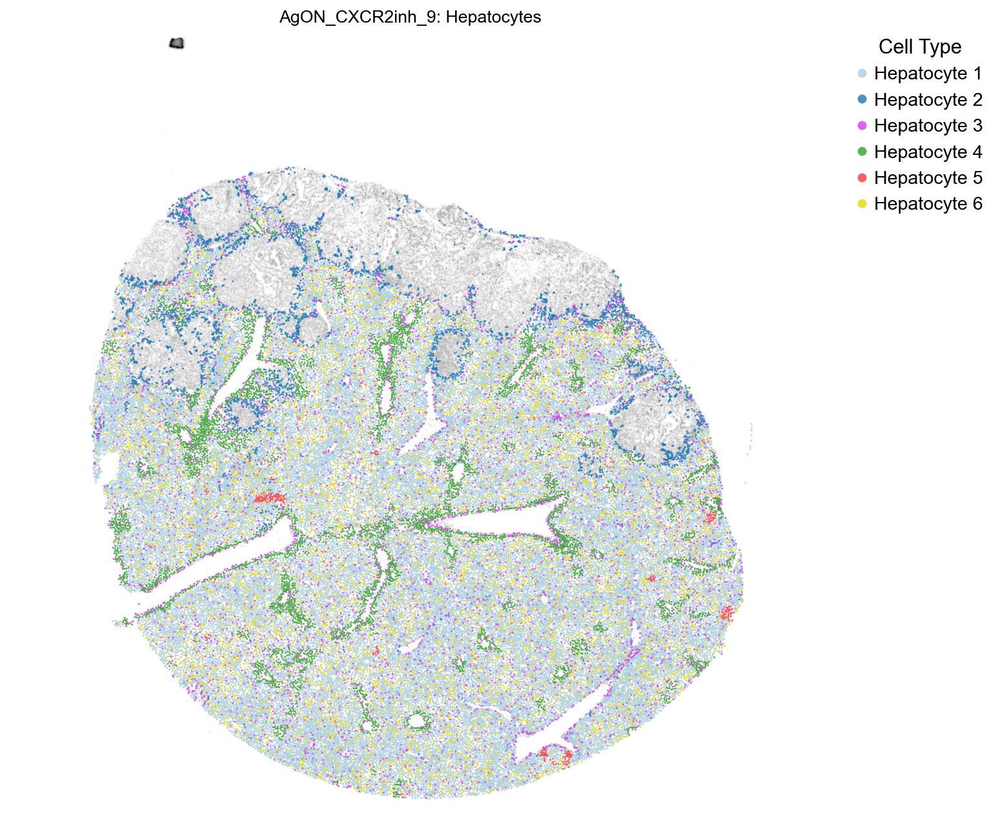

In [24]:
folder = 'AgON_CXCR2inh_9'
sample = '9'

celltypes = ['Hepatocyte 1', 'Hepatocyte 2', 'Hepatocyte 3', 
             'Hepatocyte 4', 'Hepatocyte 5', 'Hepatocyte 6']

celltype_colors = {
    "Hepatocyte 1": "#a6cee3",
    "Hepatocyte 2": "#1f78b4",
    "Hepatocyte 3": "#d23ef0",
    "Hepatocyte 4": "#33a02c",
    "Hepatocyte 5": "#f53a38",
    "Hepatocyte 6": "#e3d80b"
}

spatial_plots_dir = './spatial_plots'

# Load the MIP image
mip_path = os.path.join(spatial_plots_dir, folder, 'morphology_mip.ome.tif')
with tifffile.TiffFile(mip_path) as tif:
    image = tif.series[0].levels[0].asarray()

# Rescale the image
resample = scipy.ndimage.zoom(image, 0.2125)

# Filter the AnnData object for this sample
adata_sample = adata_integrated[adata_integrated.obs['sample'] == sample]

# Filter for hepatocyte subtypes
adata_hepatocytes = adata_sample.obs[adata_sample.obs['celltype'].isin(celltypes)].copy()

# subtypes categorical ordering
adata_hepatocytes['celltype'] = pd.Categorical(
    adata_hepatocytes['celltype'], 
    categories=celltypes, 
    ordered=True
)

# Plot
plt.figure(figsize=(10, 10))
plt.imshow(resample, cmap='binary')

sns.scatterplot(
    x='x_centroid', y='y_centroid',
    data=adata_hepatocytes,
    hue='celltype',
    palette=celltype_colors,
    s=1.5, alpha=0.8,
    legend='full',
    edgecolor=None
)

plt.title(f'{folder}: Hepatocytes', fontsize=12)
plt.xlabel('')
plt.ylabel('')
plt.xticks([])
plt.yticks([])
for spine in plt.gca().spines.values():
    spine.set_visible(False)

plt.legend(title='Cell Type', bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0., frameon=False, markerscale=5)

output_pdf = f'{folder}_Hepatocytes_whole_plot_celltypesMarked_subtypes.pdf'
plt.savefig(output_pdf, format='pdf', bbox_inches='tight')
plt.show()
plt.close()

#### Tumor subtypes analysis

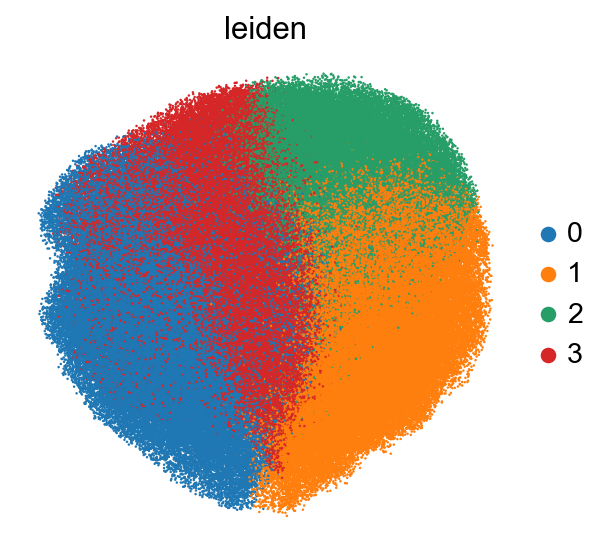

In [25]:
adata_tumors = adata_integrated[adata_integrated.obs['leiden'].isin(['1', '5'])].copy() # cluster 1 & 5 = tumor 

sc.pp.neighbors(adata_tumors, use_rep='X_scVI') 

# sub-cluster tumors 
sc.tl.umap(adata_tumors)
sc.tl.leiden(adata_tumors, resolution=0.3)
sc.pl.umap(adata_tumors, color=['leiden'], s=5, frameon=False, save='_Suppl_FigS10B.pdf')

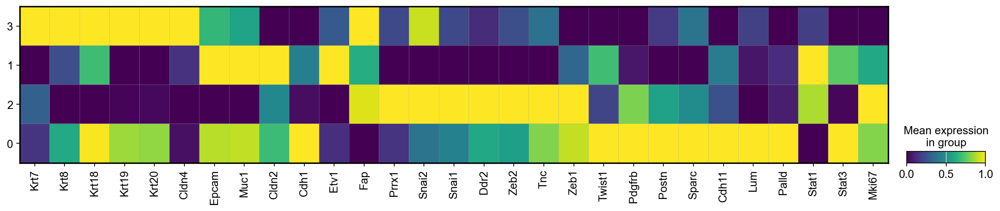

In [26]:
# order genes in cluster order
gene_list = ['Krt7','Krt8','Krt18','Krt19','Krt20','Cldn4', 'Epcam', 'Muc1', 'Cldn2', 'Cdh1', # Epithelial genes
                 'Etv1', 'Fap', 'Prrx1','Snai2','Snai1','Ddr2','Zeb2','Tnc','Zeb1', 'Twist1', 'Pdgfrb','Postn','Sparc', 'Cdh11', 'Lum', 'Palld', # Mesenchymal genes
                 'Stat1','Stat3','Mki67']

# order tumor subset groups 
manual_order = ['3', '1', '2', '0'] 

adata_tumors.obs["leiden"] = pd.Categorical(
    adata_tumors.obs["leiden"], 
    categories=manual_order, 
    ordered=True
)

sc.pl.matrixplot(adata_tumors, 
                 figsize=(18,3),
                 var_names=gene_list, 
                 groupby="leiden",
                 standard_scale='var', 
                 var_group_labels=None,
                 dendrogram=False, 
                 save='FigS10A.pdf')

Skipping folder AgOFF_CXCR2inh_5.
Skipping folder AgOFF_CXCR2inh_3.


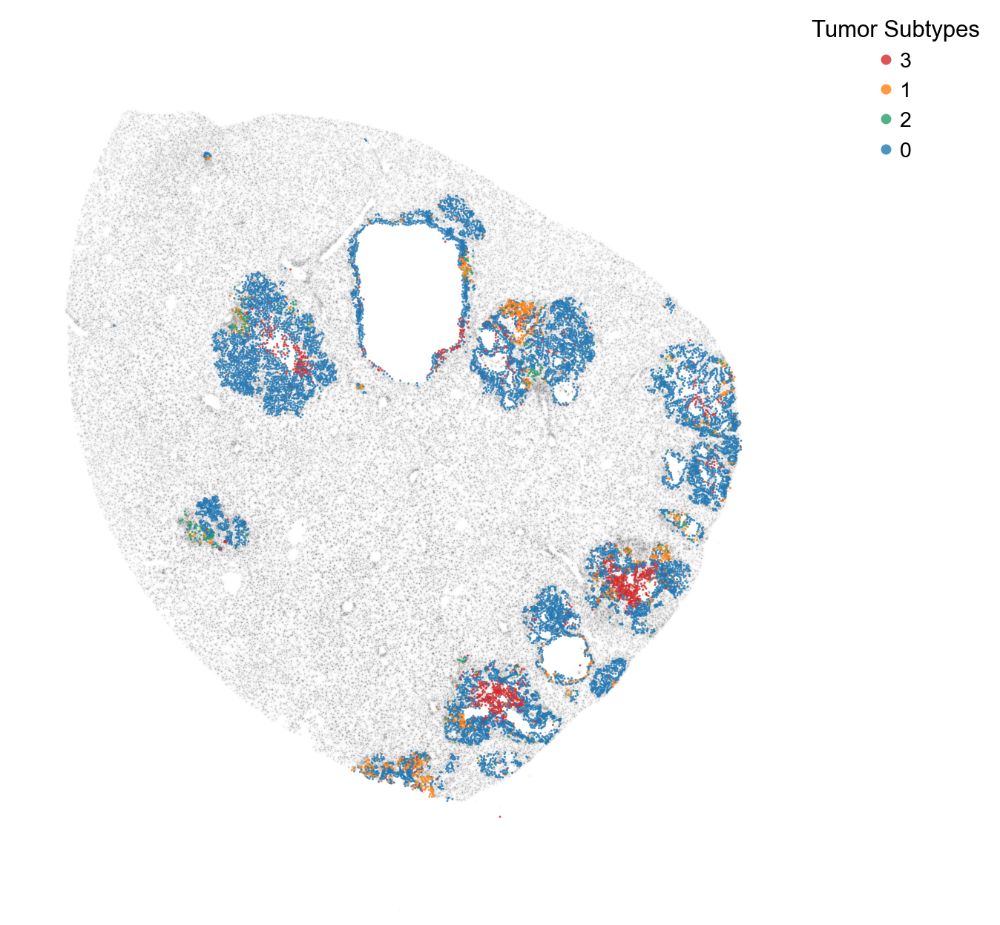

Skipping folder AgOFF_2.


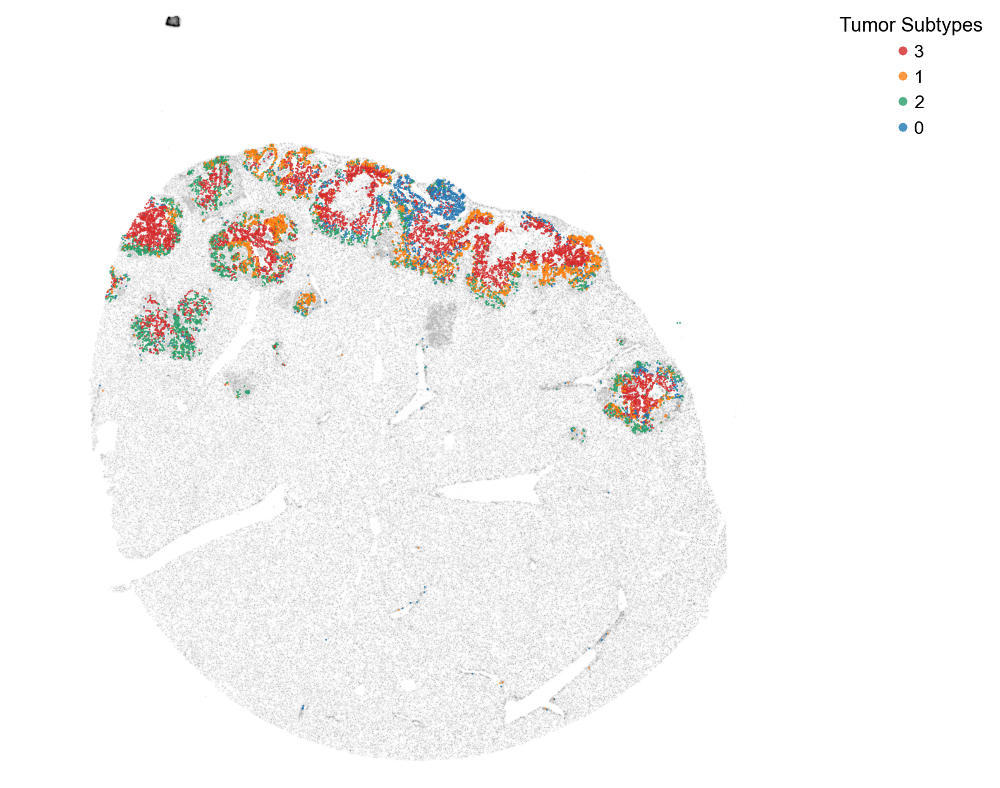

Skipping folder AgON_7.


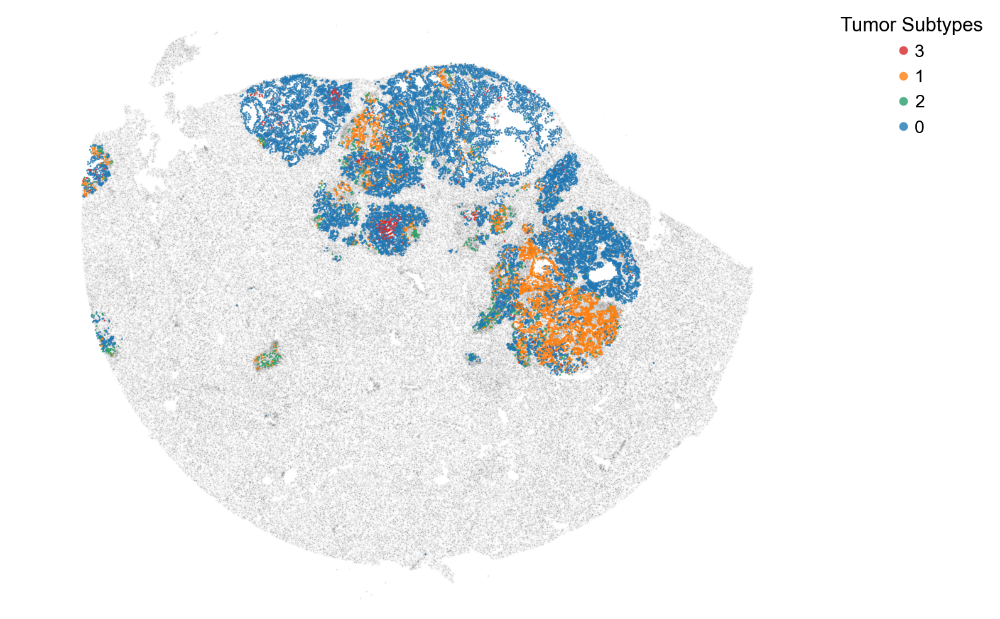

Skipping folder AgON_8.


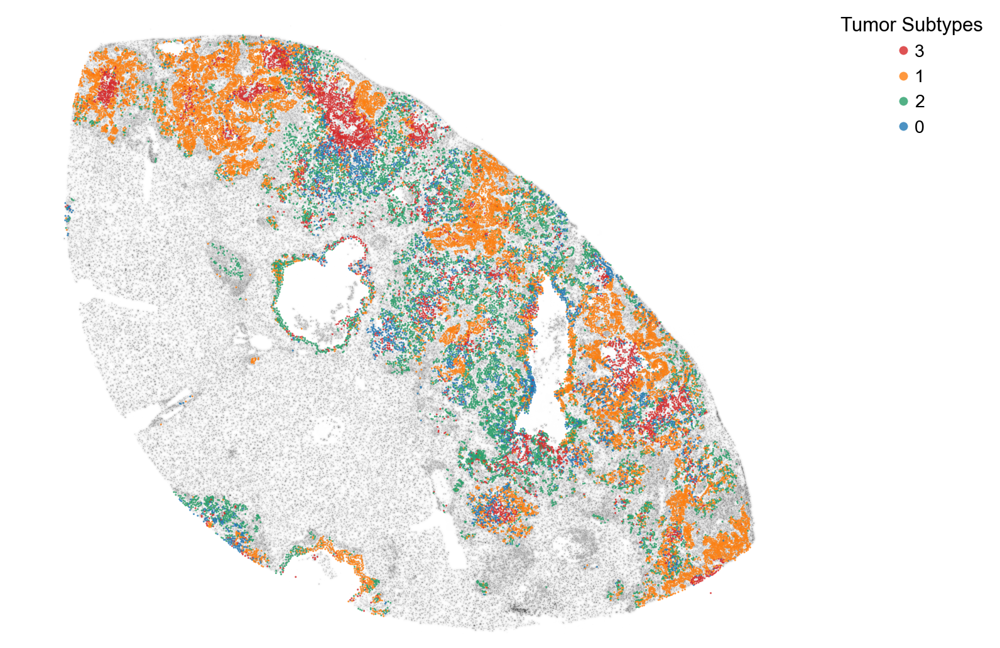

Skipping folder AgOFF_1.
Skipping folder AgON_CXCR2inh_11.
Skipping folder AgON_CXCR2inh_10.


In [27]:
leiden_colors = { 
    "0":"#1f77b4",
    "1":"#ff7f0e", 
    "2":"#279e68",
    "3":"#d62728"
}

spatial_plots_dir = './spatial_plots'
ag_folders = [folder for folder in os.listdir(spatial_plots_dir) if 'Ag' in folder]

condition_to_sample = {
    'AgOFF_0': '0',
    'AgOFF_CXCR2inh_4': '4',
    'AgON_6': '6',
    'AgON_CXCR2inh_9': '9'
}

for folder in ag_folders:
    # Extract the condition and corresponding sample
    condition = folder  # folder name labelled with condition and sample ID 
    sample = condition_to_sample.get(condition)
    
    if sample is None:
        print(f"Skipping folder {folder}.")
        continue
    
    # Load MIP image for current folder
    mipurl = os.path.join(spatial_plots_dir, folder, 'morphology_mip.ome.tif')
    with tifffile.TiffFile(mipurl) as tif:
        image = tif.series[0].levels[0].asarray()

        # Rescale image
        resample = scipy.ndimage.zoom(image, 0.2125)

    # Filter adata for the current sample
    adata_filter = adata_tumors[adata_tumors.obs['sample'] == sample]
    
    # Plot 
    plt.rcParams["figure.figsize"] = (10, 10)
    plt.imshow(resample, cmap='binary')

    sns.scatterplot(
        x='x_centroid', y='y_centroid',
        data=adata_filter.obs,
        hue='leiden',
        palette=leiden_colors,
        s=1.5, alpha=0.8,
        legend='full',
        edgecolor=None
    )

    plt.title('')
    plt.xlabel('')
    plt.ylabel('')
    plt.xticks([])
    plt.yticks([])

    # Remove the border around the plot
    for spine in plt.gca().spines.values():
        spine.set_visible(False)

    legend = plt.legend(
    title='Tumor Subtypes',
    bbox_to_anchor=(1.05, 1),     
    loc='upper left',
    borderaxespad=0.,
    frameon=False,
    markerscale=5) 

    output_pdf = f'{folder}_tumor_subtypes.pdf'
    plt.savefig(output_pdf, format='pdf', bbox_inches='tight')
    plt.show()
    plt.close()